# Applying the Data Analysis Method to a Research Problem

# 1. Determine Research Objectives and Assess the Situation  <a class="anchor" id="Businessunderstanding"></a>
The first stage of the process is to understand what you want to accomplish from a research perspective. You may have competing objectives and constraints that must be properly balanced. The goal of this stage of the process is to uncover important factors that could influence the outcome of the project. Neglecting this step can mean that a great deal of effort is put into producing the right answers to the wrong questions.

## 1.1. Climate change past, present and future <a class="anchor" id="Title"></a>


## 1.2. Introduction <a class="anchor" id="Introduction"></a> 

The aim of this project is to discover whether or that the average temperature is rising over time due to climate change.

I found many papers relevant to my research on this topic. I looked through a few paper and read some articles related to my topic. Climate change has been in the news even more recently due to the World Meteorological Organization suggesting an increase of 3 degrees to 5 degrees Celsius by the end of the century. It also shows how far off the planet is of meeting its target of 1.5 degrees. The past decade has been the hottest since 1850.

This is an important issue as some countries will benefit from this as a warmer climate exposes riches currently locked up on ice. Greenland now had an extra 2 week for its growing season. Russia will benefit from the ice caps melt creating new shipping lanes. In Siberia they will have access to untapped oil, fertile soil for agriculture, and thousands
and thousands of miles of land that could be profitably developed.

Then there are countries that will be extremely affect due to rising sea levels such as Tuvalu, one of the smallest countries. It is a small low-lying island in the pacific ocean with ten-thousand residents. With predicts of sea level rising 7m metres it would be completely be below sea level as the country’s highest point is 4.9 metres.


## 1.3.Terminology and Key Words<a class="anchor" id="Terminology"></a>
- dt - Dates from the dataset
- LandAverageTemperature - average land temperature


## 1.2.Background <a class="anchor" id="Background"></a>

I looked at resources from NASA, UCSUSA and IOPscience.

From my research of the resources one of the scientific journals I looked at found that 90%-100% of publishing climate scientists believe that the climate is changing due to humans. It also found that no papers from 928 papers that not one of the papers rejected climate change. 
-https://iopscience.iop.org/article/10.1088/1748-9326/11/4/048002

Studies from NASA found that the warmest years have all occurred since 2001, except for 1998.
Since the 1880s, the average global surface temperature has risen about 1 degree Celsius. This warming has been driven in large part by increased emissions into the atmosphere of carbon dioxide and other greenhouse gases caused by human activities

With examples like these I wish to see how the temperature is rising over time and does it look like it will continue.


 ## 1.3 Research Question <a class="anchor" id="Research Question"></a>

Is the average temperature on Earth rising?

 ## 1.4 Methodology/Methods <a class="anchor" id="Methodology/Methods"></a>

- The method i used to try and see if the average temperature id rising is Facebooks Prophet allowing me to make time series prediction with accuracy. I chose this because it provides the ability to intuitively provide parameters to look at future trends in temperature.

- I used Folium which a python library to create a map to display average temperature in a country.

- I used matplotlib.ticker to format and matplotlib.animation to animate a chart over time with IPython.display


# 2. Stage  Two - Data Understanding <a class="anchor" id="Dataunderstanding"></a>


## 2.1 Initial Data Report <a class="anchor" id="Datareport"></a>
Initial data collection report - 
List the data sources acquired together with their locations, the methods used to acquire them and any problems encountered. Record problems you encountered and any resolutions achieved. This will help both with future replication of this project and with the execution of similar future projects.

In [1]:
#!pip install plotly
#!pip install folium

In [2]:
import folium
import folium.plugins
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import seaborn as sns
import time
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML
from   sklearn import linear_model
import warnings
warnings.filterwarnings('ignore')

from os import listdir
from os.path import isfile, join
mypath = 'input'
#https://stackoverflow.com/questions/3207219/how-do-i-list-all-files-of-a-directory
onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
print(onlyfiles)

['GlobalLandTemperaturesByCity.csv', 'GlobalLandTemperaturesByCountry.csv', 'GlobalLandTemperaturesByMajorCity.csv', 'GlobalLandTemperaturesByState.csv', 'GlobalTemperatures.csv']


In [3]:
global_temp_country = pd.read_csv('input/GlobalLandTemperaturesByCountry.csv')
df_global=pd.read_csv('input/GlobalTemperatures.csv')
df_city=pd.read_csv('input/GlobalLandTemperaturesByCity.csv')


## 2.2 Describe Data <a class="anchor" id="Describedata"></a>
Data description report - Describe the data that has been acquired including its format, its quantity (for example, the number of records and fields in each table), the identities of the fields and any other surface features which have been discovered. Evaluate whether the data acquired satisfies your requirements.

In [4]:
print("---global_temp_country.columns---")
print(global_temp_country.columns)
print("\n\n---df_city.columns---")
print(df_city.columns)

---global_temp_country.columns---
Index(['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'Country'], dtype='object')


---df_city.columns---
Index(['dt', 'AverageTemperature', 'AverageTemperatureUncertainty', 'City',
       'Country', 'Latitude', 'Longitude'],
      dtype='object')


In [5]:
print("---global_temp_country.shape---")
print(global_temp_country.shape)
print("\n\n---df_city.shape---")
print(df_city.shape)

---global_temp_country.shape---
(577462, 4)


---df_city.shape---
(8599212, 7)


In [6]:
print("---global_temp_country.dtypes---")
print(global_temp_country.dtypes)
print("\n\n---df_city.dtypes---")
print(df_city.dtypes)

---global_temp_country.dtypes---
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
Country                           object
dtype: object


---df_city.dtypes---
dt                                object
AverageTemperature               float64
AverageTemperatureUncertainty    float64
City                              object
Country                           object
Latitude                          object
Longitude                         object
dtype: object


In [7]:
print("---global_temp_country.describe()---")
global_temp_country.describe()

---global_temp_country.describe()---


,AverageTemperature,AverageTemperatureUncertainty
count,544811.000000,545550.000000
mean,17.193354,1.019057
std,10.953966,1.201930
min,-37.658000,0.052000
25%,10.025000,0.323000
50%,20.901000,0.571000
75%,25.814000,1.206000
max,38.842000,15.003000


In [8]:
print("\n\n---df_city.describe()---")
df_city.describe()



---df_city.describe()---


,AverageTemperature,AverageTemperatureUncertainty
count,8.235082e+06,8.235082e+06
mean,1.672743e+01,1.028575e+00
std,1.035344e+01,1.129733e+00
min,-4.270400e+01,3.400000e-02
25%,1.029900e+01,3.370000e-01
50%,1.883100e+01,5.910000e-01
75%,2.521000e+01,1.349000e+00
max,3.965100e+01,1.539600e+01


In [9]:
global_temp_country.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
dt                               577462 non-null object
AverageTemperature               544811 non-null float64
AverageTemperatureUncertainty    545550 non-null float64
Country                          577462 non-null object
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


In [10]:
global_temp_country.head(5)

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland


In [11]:
df_city.head(5)

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Århus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Århus,Denmark,57.05N,10.33E


## 2.3 Verify Data Quality <a class="anchor" id="Verifydataquality"></a>

### 2.3.1. Missing Data <a class="anchor" id="MissingData"></a>


In [12]:
global_temp_country.isnull().sum()

dt                                   0
AverageTemperature               32651
AverageTemperatureUncertainty    31912
Country                              0
dtype: int64

In [13]:
def missing_values_table(global_temp_country):
        mis_val = global_temp_country.isnull().sum()
        mis_val_percent = 100 * global_temp_country.isnull().sum() / len(global_temp_country)
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(global_temp_country.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        return mis_val_table_ren_columns

In [14]:
missing_values_table(global_temp_country)

Your selected dataframe has 4 columns.
There are 2 columns that have missing values.


,Missing Values,% of Total Values
AverageTemperature,32651,5.7
AverageTemperatureUncertainty,31912,5.5


In [15]:
# Get the columns with > 50% missing
missing_df = missing_values_table(global_temp_country);
missing_columns = list(missing_df[missing_df['% of Total Values'] > 50].index)
print('We will remove %d columns.' % len(missing_columns))

Your selected dataframe has 4 columns.
There are 2 columns that have missing values.
We will remove 0 columns.


### 2.3.2. Outliers <a class="anchor" id="Outliers"></a>


In [16]:
outliers=[]
def detect_outlier(df_city):
    
    threshold=5
    mean_1 = np.mean(df_city)
    std_1 =np.std(df_city)
    
    
    for y in df_city:
        z_score= (y - mean_1)/std_1 
        if np.abs(z_score) > threshold:
            outliers.append(y)
    return outliers

In [17]:
outlier_datapoints = detect_outlier(df_city['AverageTemperature'])
print(outlier_datapoints)

[-35.874, -36.462, -36.593, -36.728, -35.853, -35.93199999999999, -35.44, -36.596, -38.396, -38.951, -37.219, -36.5, -37.029, -41.101000000000006, -36.391999999999996, -38.69300000000001, -35.517, -35.956, -36.574, -35.643, -39.038, -37.625, -35.73300000000001, -36.891999999999996, -36.146, -35.652, -35.145, -35.47, -35.146, -38.906, -36.251, -35.758, -35.996, -35.108999999999995, -37.488, -36.714, -35.38, -38.085, -36.003, -35.742, -35.15, -35.161, -37.128, -36.438, -38.715, -35.259, -35.62300000000001, -35.366, -36.124, -35.736, -35.418, -35.924, -36.645, -35.747, -37.0, -35.51300000000001, -37.869, -35.436, -39.919, -36.176, -36.707, -38.784, -39.683, -35.241, -39.403, -42.70399999999999, -36.108000000000004, -36.446, -37.24800000000001, -38.447, -38.389, -38.344, -35.711, -35.952, -37.713, -37.44300000000001, -36.559, -36.72, -36.881]


In [18]:
import numpy as np
#https://docs.scipy.org/doc/numpy-1.15.0/reference/generated/numpy.percentile.html#numpy-percentile
df = df_city[np.isfinite(df_city['AverageTemperature'])]
q1_l = np.percentile(df['AverageTemperature'], 25, interpolation='midpoint')
q3_h = np.percentile(df['AverageTemperature'], 75, interpolation='midpoint')
print("---Interquartile range (IQR)---\n") 
print(q3_h - q1_l)

---Interquartile range (IQR)---

14.911000000000001


## 2.4 Initial Data Exploration  <a class="anchor" id="Exploredata"></a>


### 2.4.1 Distributions  <a class="anchor" id="Distributions"></a>

In [19]:
col = 'AverageTemperature'
def count_values_table(global_temp_country):
        count_val = pd.value_counts(global_temp_country[col].values.flatten())
        count_val_percent = 100 * pd.value_counts(global_temp_country[col].values.flatten()) / len(global_temp_country[col])
        count_val_table = pd.concat([count_val, count_val_percent.round(1)], axis=1)
        count_val_table_ren_columns = count_val_table.rename(
        columns = {0 : 'Count Values', 1 : '% of Total Values'})
        return count_val_table_ren_columns

In [20]:
# Histogram
def hist_chart(global_temp_country, col):
        plt.style.use('fivethirtyeight')
        plt.hist(global_temp_country[col].dropna(), edgecolor = 'k');
        plt.xlabel(col); plt.ylabel('Number of Entries'); 
        plt.title('Distribution of '+col);

,Count Values,% of Total Values
26.864,80,0.0
25.759,77,0.0
26.996,76,0.0
25.164,73,0.0
26.289,72,0.0
...,...,...
-9.631,1,0.0
-5.069,1,0.0
-24.030,1,0.0
-0.340,1,0.0


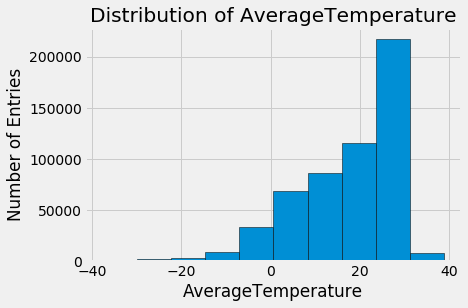

In [21]:
col = 'AverageTemperature'
# Histogram & Results
hist_chart(global_temp_country, col)
count_values_table(global_temp_country)

### 2.4.2 Correlations  <a class="anchor" id="Correlations"></a>


In [22]:
df_global.dropna(inplace=True)
#https://stackoverflow.com/questions/25146121/extracting-just-month-and-year-separately-from-pandas-datetime-column
df_global['dt']=pd.to_datetime(df_global.dt).dt.strftime('%d-%m-%Y')
def to_year(date):
    for i in [date]:
        first = i.split('-')[2]
        
         
        return int(first)
       

df_global['year'] = df_global['dt'].apply(to_year)
#calculate average temp per year
dfa = pd.DataFrame()
years = df_global['year'].unique()
for i in years:
    df_avg = df_global[df_global['year'] == i]['LandAverageTemperature'].mean()
    df_new = (df_global[df_global['year'] == i]).head(1)
    df_new['LandAverageTemperature'] = df_avg
    dfa = dfa.append(df_new)
    

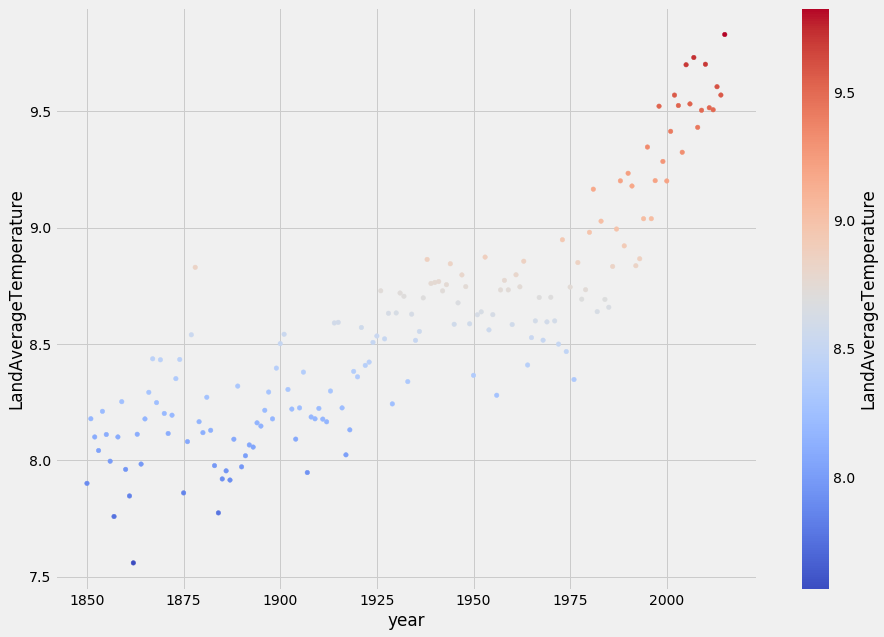

In [23]:
df_globalTemps = dfa[dfa['LandAverageTemperature'] >= 0]
plt.rcParams['figure.figsize'] = [14, 10]
df_globalTemps.plot.scatter(x='year', y='LandAverageTemperature',c = 'LandAverageTemperature', cmap ='coolwarm')

In [73]:
#https://plot.ly/python/renderers/

df_global['dt']=df_global['dt'].apply(lambda x:x[6:])
df_global=df_global.groupby(['dt'])['LandAverageTemperature'].mean().reset_index()
trace=go.Scatter(
    x=df_global['dt'],
    y=df_global['LandAverageTemperature'],
    mode='lines',
    )
data=[trace]

py.iplot(data, filename='line-mode')

In [25]:
df_global2=pd.read_csv('input/GlobalTemperatures.csv')
df_global2=df_global2[['dt','LandAverageTemperature']]
df_global2.dropna(inplace=True)
df_global2['dt']=pd.to_datetime(df_global2.dt).dt.strftime('%d/%m/%Y')
df_global2['month']=df_global2['dt'].apply(lambda x:x[3:5])
df_global2['year']=df_global2['dt'].apply(lambda x:x[6:])
df_global2=df_global2[['month','year','LandAverageTemperature']]
df_global2['month']=df_global2['month'].map({'01':'Jan','02':'Feb','03':'Mar','04':'Apr','05':'May','06':'Jun','07':'Jul','08':'Aug','09':'Sep','10':'Oct','11':'Nov','12':'Dec'})
def plot_month(month1,month2):
    a=df_global2[df_global2['month']==month1]
    b=df_global2[df_global2['month']==month2]
    trace0 = go.Scatter(
    x = a['year'],
    y = a['LandAverageTemperature'],
    mode = 'lines',
    name = month1
    )
    
    trace1 = go.Scatter(
    x = b['year'],
    y = b['LandAverageTemperature'],
    mode = 'lines',
    name = month2
    )
    data = [trace0,trace1]
    py.iplot(data, filename='line-mode')
plot_month('Dec','Jun')

In [26]:
temp_country=pd.read_csv('input/GlobalLandTemperaturesByCountry.csv')

In [27]:
temp_country['Country'].replace({'Bahamas, The':'Bahamas','Denmark (Europe)':'Denmark','France (Europe)':'France','Netherlands (Europe)':'Netherlands','United Kingdom (Europe)':'Europe'},inplace=True)
temp_country.fillna(0,inplace=True)



In [28]:
temp_country1=temp_country.groupby(['Country'])['AverageTemperature'].mean().reset_index()

In [29]:
df = pd.read_csv('input/GlobalLandTemperaturesByCity.csv', usecols=['dt', 'AverageTemperature','Country', 'City' ])
def to_year(date):
    for i in [date]:
        first = i.split('-')[0]
        return int(first)

df['year'] = df['dt'].apply(to_year)
df.fillna(0)
df.head(3)

,dt,AverageTemperature,City,Country,year
0,1743-11-01,6.068,Århus,Denmark,1743
1,1743-12-01,NaN,Århus,Denmark,1743
2,1744-01-01,NaN,Århus,Denmark,1744


In [30]:
final_year = 2013
dff = df[df['year'].eq(final_year)].sort_values(by='AverageTemperature', ascending=False).head(10)
dff

,dt,AverageTemperature,City,Country,year
4686139,2013-07-01,39.156,Masjed E Soleyman,Iran,2013
117009,2013-07-01,39.156,Ahvaz,Iran,2013
28168,2013-07-01,38.001,Abadan,Iran,2013
3796433,2013-07-01,38.001,Khorramshahr,Iran,2013
2049402,2013-07-01,37.266,Doha,Qatar,2013
4686140,2013-08-01,37.167,Masjed E Soleyman,Iran,2013
117010,2013-08-01,37.167,Ahvaz,Iran,2013
6385826,2013-07-01,37.126,Riyadh,Saudi Arabia,2013
1210401,2013-07-01,37.101,Buraydah,Saudi Arabia,2013
7224494,2013-06-01,36.971,Sukkur,Pakistan,2013


<BarContainer object of 10 artists>

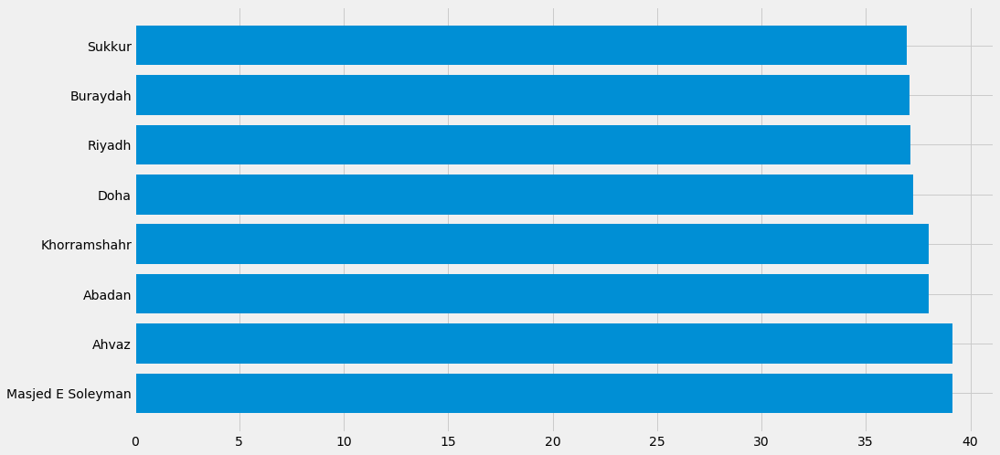

In [31]:
fig, ax = plt.subplots(figsize=(15, 8))
ax.barh(dff['City'], dff['AverageTemperature'])

In [32]:
dff['Country'].replace({'Denmark (Europe)':'Denmark','France (Europe)':'France','Netherlands (Europe)':'Netherlands','United Kingdom (Europe)':'Europe'},inplace=True)
dff.fillna(0,inplace=True)

In [33]:
colors = dict(zip(
    ['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra','Angola', 'Anguilla', 'Antigua and Barbuda', 'Argentina', 'Armenia','Aruba', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas, The',
       'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize','Benin', 'Bermuda', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina','Botswana', 'Brazil', 'British Virgin Islands', 'Brunei',
       'Bulgaria', 'Burkina Faso', 'Burma', 'Burundi', 'Cabo Verde','Cambodia', 'Cameroon', 'Canada', 'Cayman Islands','Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Comoros', 'Congo, Democratic Republic of the','Congo, Republic of the', 'Cook Islands', 'Costa Rica',"Cote d'Ivoire", 'Croatia', 'Cuba', 'Curacao', 'Cyprus','Czech Republic', 'Denmark', 'Djibouti', 'Dominica','Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
       'Equatorial Guinea', 'Eritrea', 'Estonia', 'Ethiopia','Falkland Islands (Islas Malvinas)', 'Faroe Islands', 'Fiji','Finland', 'France', 'French Polynesia', 'Gabon', 'Gambia, The',
       'Georgia', 'Germany', 'Ghana', 'Gibraltar', 'Greece', 'Greenland','Grenada', 'Guam', 'Guatemala', 'Guernsey', 'Guinea-Bissau','Guinea', 'Guyana', 'Haiti', 'Honduras', 'Hong Kong', 'Hungary',
       'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ireland','Isle of Man', 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jersey','Jordan', 'Kazakhstan', 'Kenya', 'Kiribati', 'Korea, North',
       'Korea, South', 'Kosovo', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Latvia','Lebanon', 'Lesotho', 'Liberia', 'Libya', 'Liechtenstein', 'Lithuania', 'Luxembourg', 'Macau', 'Macedonia', 'Madagascar','Malawi', 'Malaysia', 'Maldives', 'Mali', 'Malta',
       'Marshall Islands', 'Mauritania', 'Mauritius', 'Mexico','Micronesia, Federated States of', 'Moldova', 'Monaco', 'Mongolia',
       'Montenegro', 'Morocco', 'Mozambique', 'Namibia', 'Nepal','Netherlands', 'New Caledonia', 'New Zealand', 'Nicaragua','Nigeria', 'Niger', 'Niue', 'Northern Mariana Islands', 'Norway',
       'Oman', 'Pakistan', 'Palau', 'Panama', 'Papua New Guinea','Paraguay', 'Peru', 'Philippines', 'Poland', 'Portugal','Puerto Rico', 'Qatar', 'Romania', 'Russia', 'Rwanda','Saint Kitts and Nevis', 'Saint Lucia', 'Saint Martin','Saint Pierre and Miquelon', 'Saint Vincent and the Grenadines','Samoa', 'San Marino', 'Sao Tome and Principe', 'Saudi Arabia','Senegal', 'Serbia', 'Seychelles', 'Sierra Leone', 'Singapore',
       'Sint Maarten', 'Slovakia', 'Slovenia', 'Solomon Islands','Somalia', 'South Africa', 'South Sudan', 'Spain', 'Sri Lanka','Sudan', 'Suriname', 'Swaziland', 'Sweden', 'Switzerland', 'Syria',
       'Taiwan', 'Tajikistan', 'Tanzania', 'Thailand', 'Timor-Leste', 'Togo', 'Tonga', 'Trinidad and Tobago', 'Tunisia', 'Turkey','Turkmenistan', 'Tuvalu', 'Uganda', 'Ukraine',
       'United Arab Emirates', 'United Kingdom', 'United States','Uruguay', 'Uzbekistan', 'Vanuatu', 'Venezuela', 'Vietnam',
       'Virgin Islands', 'West Bank', 'Yemen', 'Zambia', 'Zimbabwe'],
    ['#adb0ff', '#ffb3ff', '#90d595', '#e48381', '#aafbff', '#f7bb5f', '#eafb50','#63b598', '#ce7d78', '#ea9e70', '#a48a9e', '#c6e1e8', '#648177' ,'#0d5ac1' ,
'#f205e6' ,'#1c0365' ,'#14a9ad' ,'#4ca2f9' ,'#a4e43f' ,'#d298e2' ,'#6119d0',
'#d2737d' ,'#c0a43c' ,'#f2510e' ,'#651be6' ,'#79806e' ,'#61da5e' ,'#cd2f00' ,
'#9348af' ,'#01ac53' ,'#c5a4fb' ,'#996635','#b11573' ,'#4bb473' ,'#75d89e' ,
'#2f3f94' ,'#2f7b99' ,'#da967d' ,'#34891f' ,'#b0d87b' ,'#ca4751' ,'#7e50a8' ,
'#c4d647' ,'#e0eeb8' ,'#11dec1' ,'#289812' ,'#566ca0' ,'#ffdbe1' ,'#2f1179' ,
'#935b6d' ,'#916988' ,'#513d98' ,'#aead3a', '#9e6d71', '#4b5bdc', '#0cd36d',
'#250662', '#cb5bea', '#228916', '#ac3e1b', '#df514a', '#539397', '#880977',
'#f697c1', '#ba96ce', '#679c9d', '#c6c42c', '#5d2c52', '#48b41b', '#e1cf3b',
'#5be4f0', '#57c4d8', '#a4d17a', '#225b8', '#be608b', '#96b00c', '#088baf',
'#f158bf', '#e145ba', '#ee91e3', '#05d371', '#5426e0', '#4834d0', '#802234',
'#6749e8', '#0971f0', '#8fb413', '#b2b4f0', '#c3c89d', '#c9a941', '#41d158',
'#fb21a3', '#51aed9', '#5bb32d', '#21538e', '#89d534', '#d36647',
'#7fb411', '#0023b8', '#3b8c2a', '#986b53', '#f50422', '#983f7a', '#ea24a3',
'#79352c', '#521250', '#c79ed2', '#d6dd92', '#e33e52', '#b2be57', '#fa06ec',
'#1bb699', '#6b2e5f', '#64820f', '#1c271', '#21538e', '#89d534', '#d36647',
'#7fb411', '#0023b8', '#3b8c2a', '#986b53', '#f50422', '#983f7a', '#ea24a3',
'#79352c', '#521250', '#c79ed2', '#d6dd92', '#e33e52', '#b2be57', '#fa06ec',
'#1bb699', '#6b2e5f', '#64820f', '#1c271', '#9cb64a', '#996c48', '#9ab9b7',
'#06e052', '#e3a481', '#0eb621', '#fc458e', '#b2db15', '#aa226d', '#792ed8',
'#73872a', '#520d3a', '#cefcb8', '#a5b3d9', '#7d1d85', '#c4fd57', '#f1ae16',
'#8fe22a', '#ef6e3c', '#243eeb', '#1dc18', '#dd93fd', '#3f8473', '#e7dbce',
'#421f79', '#7a3d93', '#635f6d', '#93f2d7', '#9b5c2a', '#15b9ee', '#0f5997',
'#409188', '#911e20', '#1350ce', '#10e5b1', '#fff4d7', '#cb2582', '#ce00be',
'#32d5d6', '#608572', '#c79bc2', '#00f87c', '#77772a', '#6995ba',
'#fc6b57', '#f07815', '#8fd883', '#060e27', '#96e591', '#21d52e', '#d00043',
'#b47162', '#1ec227', '#4f0f6f', '#1d1d58', '#947002', '#bde052', '#e08c56',
'#28fcfd', '#bb09b', '#36486a', '#d02e29', '#1ae6db', '#3e464c', '#a84a8f',
'#911e7e', '#3f16d9', '#0f525f', '#ac7c0a', '#b4c086', '#c9d730', '#30cc49',
'#3d6751', '#fb4c03', '#640fc1', '#62c03e', '#d3493a', '#88aa0b', '#406df9',
'#615af0', '#4be47', '#2a3434', '#4a543f', '#79bca0', '#a8b8d4', '#00efd4',
'#7ad236', '#7260d8', '#1deaa7', '#06f43a', '#823c59', '#e3d94c', '#dc1c06',
'#f53b2a', '#b46238', '#2dfff6', '#a82b89', '#1a8011', '#436a9f', '#1a806a',
'#4cf09d', '#c188a2', '#67eb4b', '#b308d3', '#fc7e41', '#af3101', '#ff065',
'#71b1f4', '#a2f8a5', '#e23dd0', '#d3486d', '#00f7f9', '#474893', '#3cec35',
'#1c65cb', '#5d1d0c', '#2d7d2a', '#ff3420', '#5cdd87', '#a259a4', '#e4ac44',
'#1bede6', '#8798a4', '#d7790f', '#b2c24f', '#de73c2', '#d70a9c', '#25b67',
'#88e9b8', '#c2b0e2', '#86e98f', '#ae90e2', '#1a806b', '#436a9e', '#0ec0ff',
'#f812b3', '#b17fc9', '#8d6c2f', '#d3277a', '#2ca1ae', '#9685eb', '#8a96c6',
'#dba2e6', '#76fc1b', '#608fa4', '#20f6ba', '#07d7f6', '#dce77a', '#77ecca']
))
group_lk = df.set_index('City')['Country'].to_dict()

Text(1, 0.4, '2013')

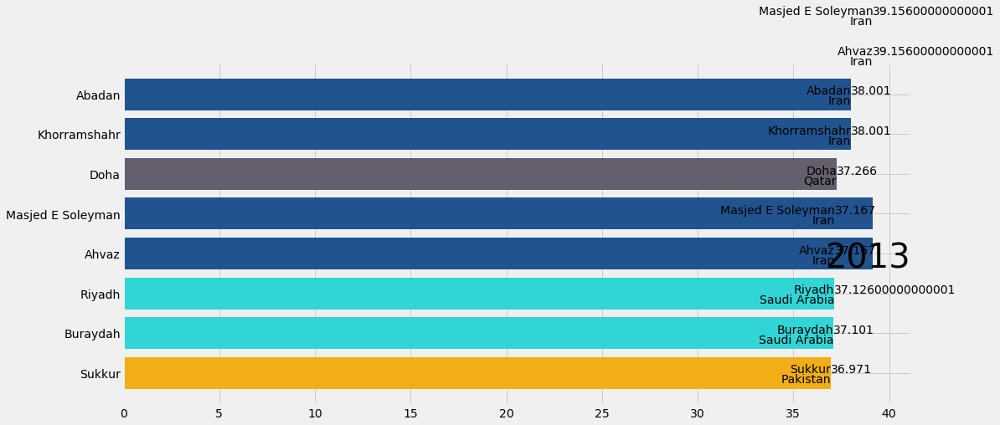

In [34]:
fig, ax = plt.subplots(figsize=(15, 7))
dff = dff[::-1] 
ax.barh(dff['City'], dff['AverageTemperature'], color=[colors[group_lk[x]] for x in dff['City']])
for i, (value, name) in enumerate(zip(dff['AverageTemperature'], dff['City'])):
    ax.text(value, i,     name,            ha='right')  # city
    ax.text(value, i-.25, group_lk[name],  ha='right')  # country
    ax.text(value, i,     value,           ha='left')   # temp

ax.text(1, 0.4, final_year, transform=ax.transAxes, size=40, ha='right')

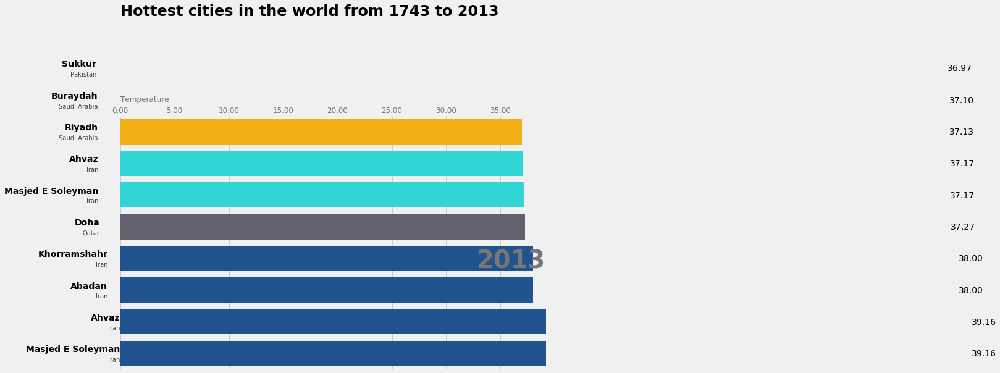

In [35]:
#https://pratapvardhan.com/blog/bar-chart-race-python-matplotlib/
fig, ax = plt.subplots(figsize=(11, 7))
year = 2013
def draw_barchart(year):
    dff = df[df['year'].eq(year)].sort_values(by='AverageTemperature', ascending=False).head(10)
    ax.clear()
    ax.barh(dff['City'], dff['AverageTemperature'], color=[colors[group_lk[x]] for x in dff['City']])
    dx = dff['AverageTemperature'].max()
    for i, (value, name) in enumerate(zip(dff['AverageTemperature'], dff['City'])):
        ax.text(value-dx, i,     name,           size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i,     f'{value:,.2f}',  size=14, ha='left',  va='center')
    # ... polished styles
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=40, ha='right', weight=800)
    ax.text(0, 1.06, 'Temperature', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.2f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.4, 'Hottest cities in the world from 1743 to 2013',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    
    plt.box(False)
    
draw_barchart(2013)

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


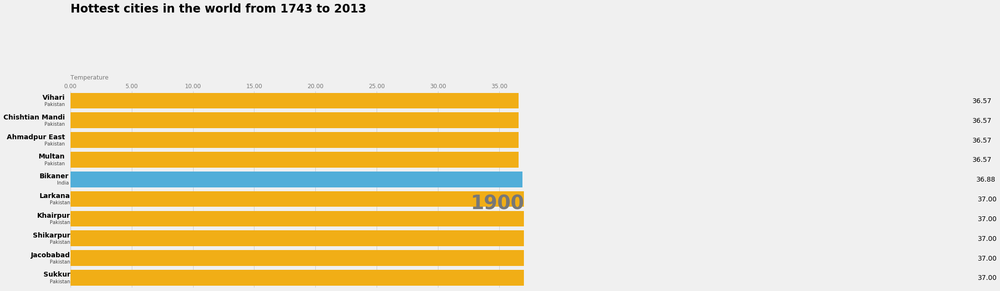

In [36]:
fig, ax = plt.subplots(figsize=(15, 7))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1900, 2013))
HTML(animator.to_jshtml()) 

In [37]:

df_city.dropna(inplace=True)
#https://stackoverflow.com/questions/25146121/extracting-just-month-and-year-separately-from-pandas-datetime-column
df_city['year']=df_city['dt'].apply(lambda x: x[:4])
df_city['month']=df_city['dt'].apply(lambda x: x[5:7])
df_city.drop('dt',axis=1,inplace=True)
df_city=df_city[['year','month','AverageTemperature','City','Country','Latitude','Longitude']]
df_city['Latitude']=df_city['Latitude'].str.strip('N')
df_city['Longitude']=df_city['Longitude'].str.strip('E')
german_cities=df_city[df_city['Country']=='Germany']
german_cities=german_cities[german_cities['year']>'1800']
cities=german_cities[german_cities['City'].isin(['Kiel','Berlin','Munich','Frankfurt','Hamburg','Cologne','Dresden','Leipzig','Heidelberg','Düsseldorf','Stuttgart'])]
heatmap=cities.groupby(['City','month'])['AverageTemperature'].mean().reset_index()
trace = go.Heatmap(z=heatmap['AverageTemperature'],
                   x=heatmap['month'],
                   y=heatmap['City'],
                  colorscale='Viridis')
data=[trace]
layout = go.Layout(
    title='Average Temperature Of Major German Cities By Month',
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='labelled-heatmap')

In [38]:
cities_g=german_cities.groupby(['City'])[['AverageTemperature']].mean().reset_index()
cities_g=cities_g.merge(german_cities,left_on='City',right_on='City',how='left')
cities_g=cities_g.drop_duplicates(subset=['City'],keep='first')

In [39]:
location=cities[['Latitude','Longitude']]
location=location.astype(float)
def color_point(x):
    if x>=28:
        color='red'
    elif ((x>15 and x<28)):
        color='blue'
    else:
        color='green'
    return color   
map1 = folium.Map(location=[50.896033, 9.5363236],tiles='CartoDB dark_matter',zoom_start=4.5)
for point in location.index:
    folium.CircleMarker(list(location.loc[point].values),popup='<b>City: </b>'+str(cities.City[point]+'<br><b>Avg Temperature:</b>'+str(cities.AverageTemperature[point])),\
                        radius=1,color=color_point(cities.AverageTemperature[point])).add_to(map1)
map1


In [40]:
df_global2=pd.read_csv('input/GlobalTemperatures.csv', parse_dates=['dt'])
mean_temp_year = df_global2.groupby(df_global2.dt.dt.year).mean()

In [41]:
mean_temp_year = df_global2.groupby(df_global2.dt.dt.year).mean()

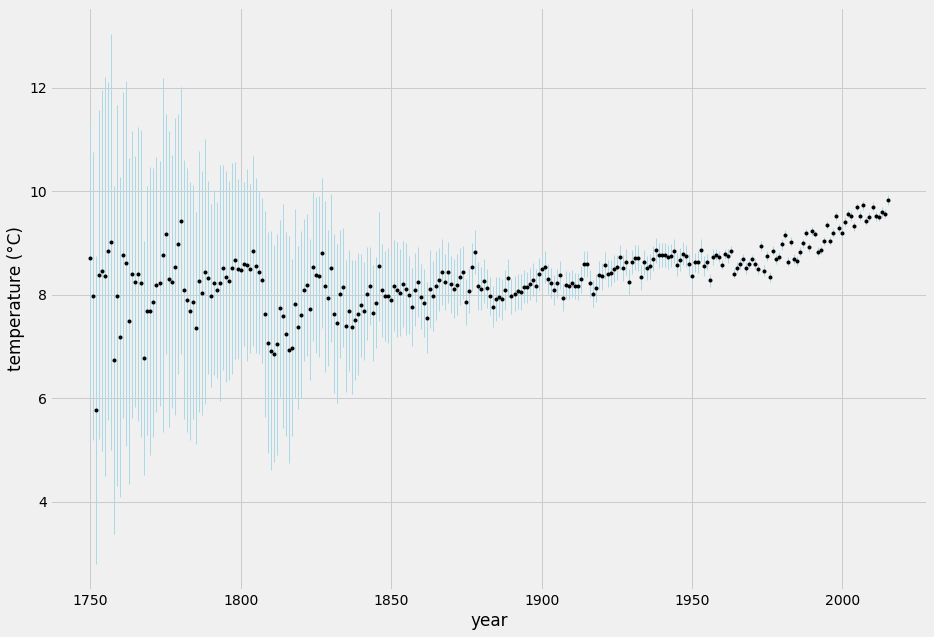

In [42]:
plt.rcParams['figure.figsize'] = [14, 10]

# https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.errorbar.html
plt.xlabel('year')
plt.ylabel('temperature (°C)')
plt.errorbar(mean_temp_year.index, mean_temp_year.LandAverageTemperature, yerr=mean_temp_year.LandAverageTemperatureUncertainty, 
             fmt='.', color='black', ecolor='lightblue', elinewidth=1)
plt.show()

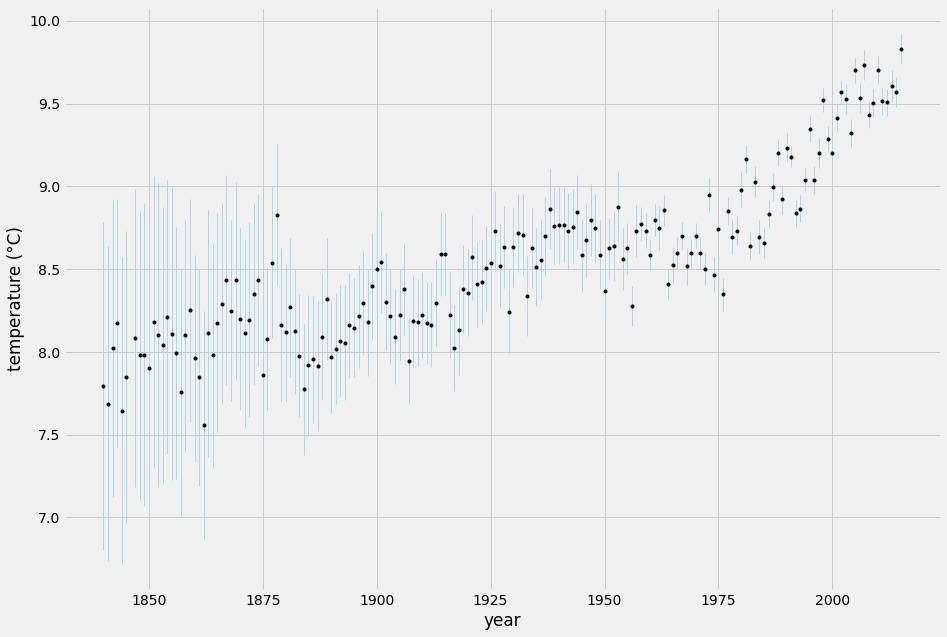

In [43]:
# Improve uncertainty 
mean_temp_year = mean_temp_year[mean_temp_year.LandAverageTemperatureUncertainty <= 1]

plt.xlabel('year')
plt.ylabel('temperature (°C)')
plt.errorbar(mean_temp_year.index, mean_temp_year.LandAverageTemperature, yerr=mean_temp_year.LandAverageTemperatureUncertainty, fmt='.', color='black', ecolor='lightblue', elinewidth=1)
plt.show()

In [44]:

temperatures = list(mean_temp_year.LandAverageTemperature)
years = list(mean_temp_year.index)

x_train = []
y_train = temperatures
for y in years:
    x_train.append([y])

reg = linear_model.Ridge(alpha=1)
reg.fit(x_train, y_train)
prediction = reg.predict(x_train)

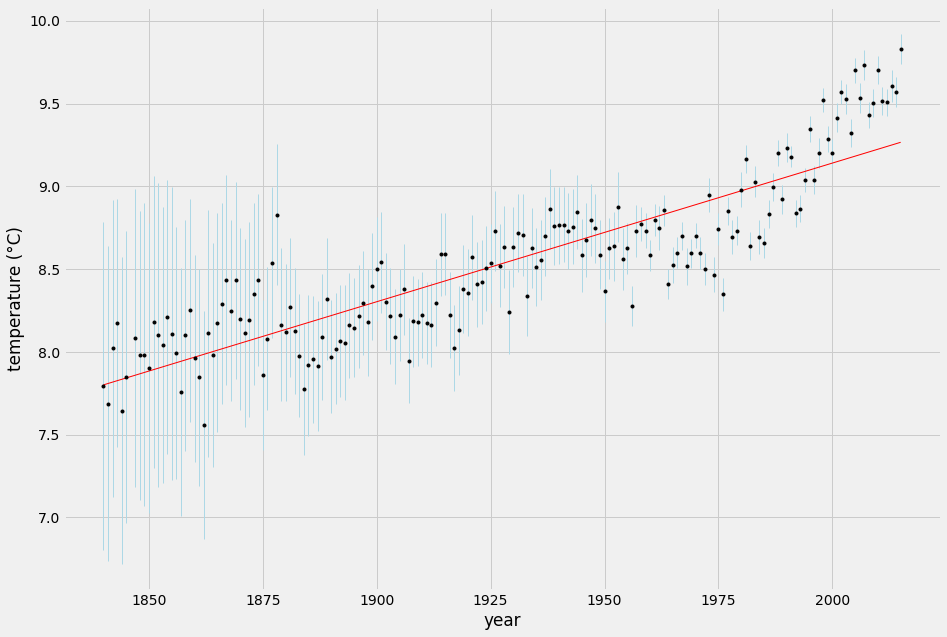

In [45]:
plt.xlabel('year')
plt.ylabel('temperature (°C)')
plt.errorbar(mean_temp_year.index, mean_temp_year.LandAverageTemperature, yerr=mean_temp_year.LandAverageTemperatureUncertainty, fmt='.', color='black', ecolor='lightblue', elinewidth=1)
plt.plot(x_train, prediction, color='r', linewidth='1')
plt.show()

In [69]:
import random

temperatures = list(mean_temp_year.LandAverageTemperature)
years = list(mean_temp_year.index)

sec_x = []
sec_y = []
sec2_x =[]
sec2_y = []
#Randomly put into different section
for y, t in zip(years, temperatures):
    choice = random.randint(0,99)
    if choice <= 20: 
        sec_x.append([y])
        sec_y.append(t)
    else:
        sec2_x.append([y])
        sec2_y.append(t)


reg = linear_model.Ridge(alpha=0)
reg.fit(sec_x, sec_y)
prediction = reg.predict(sec2_x)
score = reg.score(sec_x, sec_y)

reg2 = linear_model.Ridge(alpha=0)
reg2.fit(sec2_x, sec2_y)
prediction2 = reg2.predict(sec_x)
score2 = reg2.score(sec2_x, sec2_y)

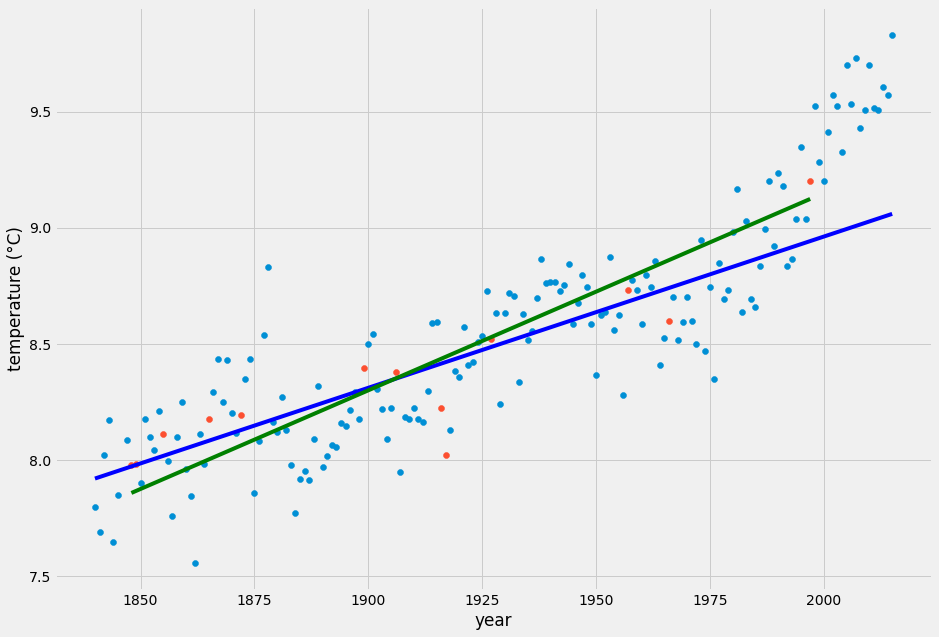

In [71]:
plt.rcParams['figure.figsize'] = [14, 10]
plt.xlabel('year')
plt.ylabel('temperature (°C)')

plt.scatter(sec2_x, sec2_y)
plt.scatter(sec_x, sec_y)
p = plt.plot(sec2_x, prediction, color='blue')
p3 = plt.plot(sec_x, prediction2, color='green')

plt.show()

## 2.5 Data Quality Report <a class="anchor" id="Dataqualityreport"></a>
List the results of the data quality verification. If quality problems exist, suggest possible solutions. Solutions to data quality problems generally depend heavily on both data and business knowledge.

# 3. Stage Three - Data Preperation <a class="anchor" id="Datapreperation"></a>
This is the stage of the project where you decide on the data that you're going to use for analysis. The criteria you might use to make this decision include the relevance of the data to your data mining goals, the quality of the data, and also technical constraints such as limits on data volume or data types. Note that data selection covers selection of attributes (columns) as well as selection of records (rows) in a table.

## 3.1 Select Your Data <a class="anchor" id="Selectyourdata"></a>
This is the stage of the project where you decide on the data that you're going to use for analysis. The criteria you might use to make this decision include the relevance of the data to your data mining goals, the quality of the data, and also technical constraints such as limits on data volume or data types. Note that data selection covers selection of attributes (columns) as well as selection of records (rows) in a table.

Rationale for inclusion/exclusion - List the data to be included/excluded and the reasons for these decisions.

In [48]:
df_f = pd.read_csv('input/GlobalTemperatures.csv')
df_f = df_f[['dt','LandAverageTemperature']].dropna()

## 3.2 Clean The Data <a class="anchor" id="Cleansethedata"></a>
This task involves raise the data quality to the level required by the analysis techniques that you've selected. This may involve selecting clean subsets of the data, the insertion of suitable defaults, or more ambitious techniques such as the estimation of missing data by modelling.

### 3.2.1 Label Encoding <a class="anchor" id="labelEncoding"></a>


In [49]:
df_f['dt'] = pd.to_datetime(df_f['dt'])
df_f = df_f.set_index('dt')


In [50]:
sub_df = df_f.resample('AS').mean()


### 3.2.2 Dealing With Zeros <a class="anchor" id="DealingZeros"></a>
Sometimes we may not need certain columns. We can drop to keep only relevent data

In [51]:
d_df = sub_df.reset_index().dropna()

### 3.2.3 Drop Unnecessary Columns <a class="anchor" id="DropCols"></a>

In [52]:

subset = d_df.reset_index()[['dt', 'LandAverageTemperature']]


### 3.2.4 Altering Data Types <a class="anchor" id="AlteringDatatypes"></a>
Sometimes we may need to alter data types. Including to/from object datatypes

In [53]:
#Columns need to be renamed ds and y for Prophet
subset.rename(columns={"dt": "ds", "LandAverageTemperature": "y"}, inplace=True)
subset.head()

,ds,y
0,1750-01-01,8.719364
1,1751-01-01,7.976143
2,1752-01-01,5.779833
3,1753-01-01,8.388083
4,1754-01-01,8.469333


### 3.2.5 Dealing With Duplicates <a class="anchor" id="DealingDuplicates"></a>
Remove duplicate rows. **Note** You may not want to do this - add / remove as required

## 3.3 Construct Required Data   <a class="anchor" id="Constructrequireddata"></a>
This task includes constructive data preparation operations such as the production of derived attributes or entire new records, or transformed values for existing attributes.

**Derived attributes** - These are new attributes that are constructed from one or more existing attributes in the same record, for example you might use the variables of length and width to calculate a new variable of area.

**Generated records** - Here you describe the creation of any completely new records. For example you might need to create records for customers who made no purchase during the past year. There was no reason to have such records in the raw data, but for modelling purposes it might make sense to explicitly represent the fact that particular customers made zero purchases.


In [54]:
subset.describe()

,y
count,266.000000
mean,8.369337
std,0.584921
min,5.779833
25%,8.081562
50%,8.372167
75%,8.704167
max,9.831000


## 3.4 Integrate Data  <a class="anchor" id="Integratedata"></a>
These are methods whereby information is combined from multiple databases, tables or records to create new records or values.

**Merged data** - Merging tables refers to joining together two or more tables that have different information about the same objects. For example a retail chain might have one table with information about each store’s general characteristics (e.g., floor space, type of mall), another table with summarised sales data (e.g., profit, percent change in sales from previous year), and another with information about the demographics of the surrounding area. Each of these tables contains one record for each store. These tables can be merged together into a new table with one record for each store, combining fields from the source tables.

**Aggregations** - Aggregations refers to operations in which new values are computed by summarising information from multiple records and/or tables. For example, converting a table of customer purchases where there is one record for each purchase into a new table where there is one record for each customer, with fields such as number of purchases, average purchase amount, percent of orders charged to credit card, percent of items under promotion etc.


## 3.5 Primary Data Set  <a class="anchor" id="Primary Data Set"></a>
Construct Our Primary Data Set, this is the pre-processed data set that will be used for the data modeling experiments.

In [55]:
subset.head()

,ds,y
0,1750-01-01,8.719364
1,1751-01-01,7.976143
2,1752-01-01,5.779833
3,1753-01-01,8.388083
4,1754-01-01,8.469333


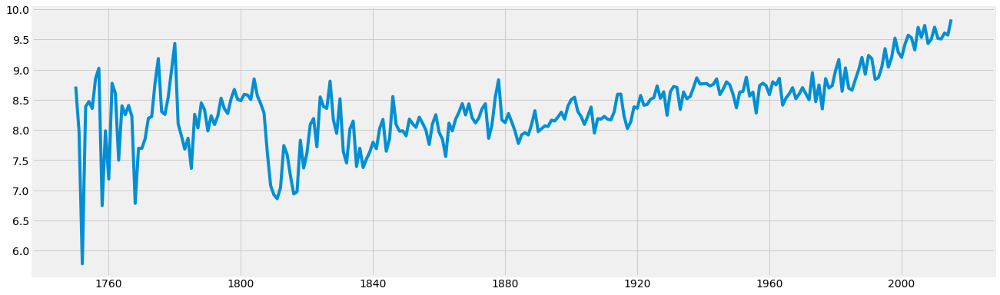

In [56]:

fig = plt.figure(facecolor='w', figsize=(20, 6))
plt.plot(subset.ds, subset.y)

# 4. Modelling <a class="anchor" id="Modelling"></a>


## 4.1. Modelling technique <a class="anchor" id="ModellingTechnique"></a>


In [ ]:
from fbprophet import Prophet

## 4.2. Modelling assumptions <a class="anchor" id="ModellingAssumptions"></a>

- Null values removed


## 5.3. Build Model <a class="anchor" id="BuildModel"></a>


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


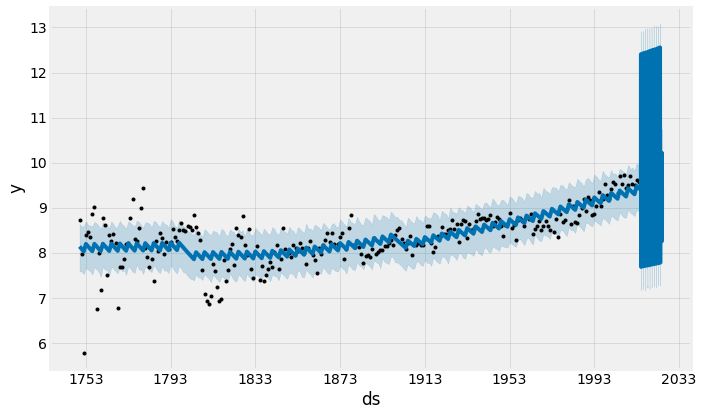

In [57]:
m = Prophet(seasonality_mode='multiplicative').fit(subset)
future = m.make_future_dataframe(periods=3652)
fcst = m.predict(future)
fig = m.plot(fcst)
#Very bad model accuracy 

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


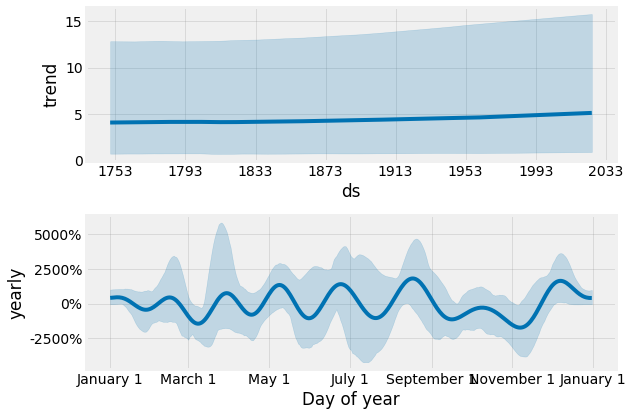

In [58]:
m = Prophet(seasonality_mode='multiplicative', mcmc_samples=300).fit(subset)
fcst = m.predict(future)
fig = m.plot_components(fcst)
#Looking at the trend of the graph

In [59]:
m = Prophet(changepoint_prior_scale=0.05)
m.fit(subset)


future = m.make_future_dataframe(periods=28, freq='12M')
forecast = m.predict(future)
# yhat is forecase and yhat_lower, yhat_upper: uncertainty interval
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,yhat,yhat_lower,yhat_upper
289,2038-01-31,10.652673,10.115558,11.176962
290,2039-01-31,10.710572,10.166885,11.202281
291,2040-01-31,10.769468,10.283128,11.274288
292,2041-01-31,10.643527,10.151555,11.183191
293,2042-01-31,10.700374,10.213776,11.204212


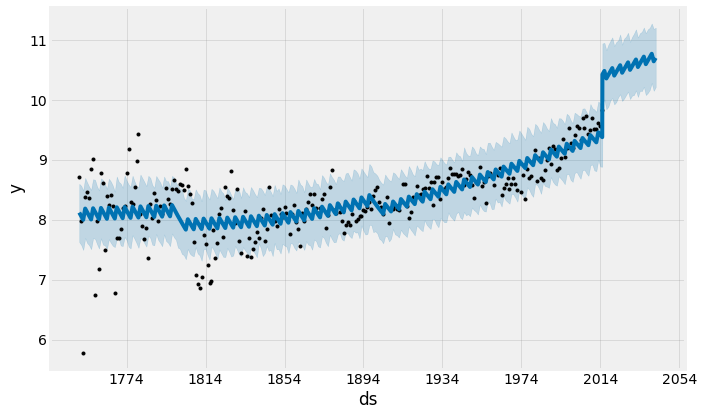

In [60]:
fig1 = m.plot(forecast)
#Graph has improved but still not correct.

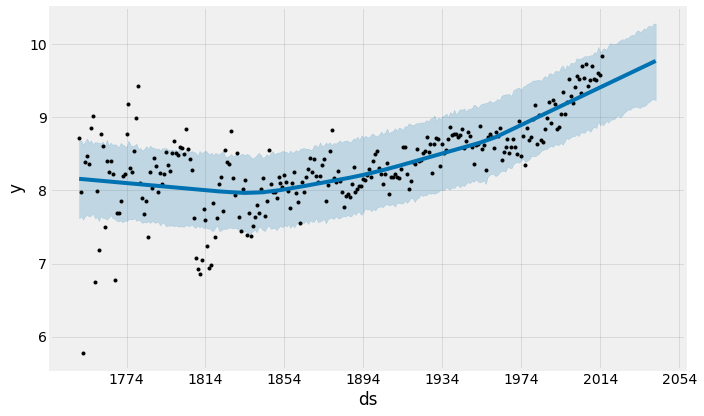

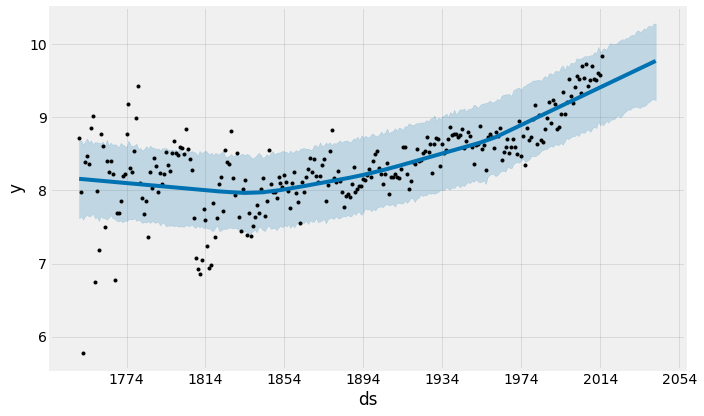

In [61]:
from datetime import datetime, timedelta

m2 = Prophet(growth='linear', 
             seasonality_prior_scale=1, 
             yearly_seasonality=False, 
             weekly_seasonality=False,
             daily_seasonality=False,
            changepoint_prior_scale=0.05)
m2.fit(subset)
forecast2 = m2.predict(future)
m2.plot(forecast2)
#Graph looks correct now.

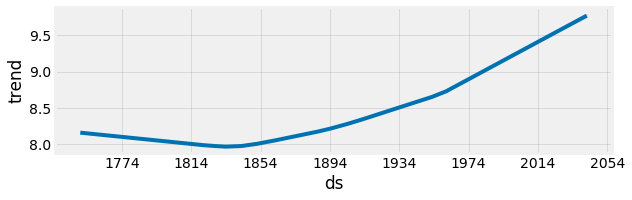

In [62]:
fig2 = m.plot_components(forecast2)

## 6. Results/Data/Findings <a class="anchor" id="Results"></a>
 


In [63]:
prophet = Prophet(yearly_seasonality=False, weekly_seasonality=False)
prophet.fit(subset)
future = prophet.make_future_dataframe(periods=25, freq='12M')

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [64]:
forecast = prophet.predict(future)

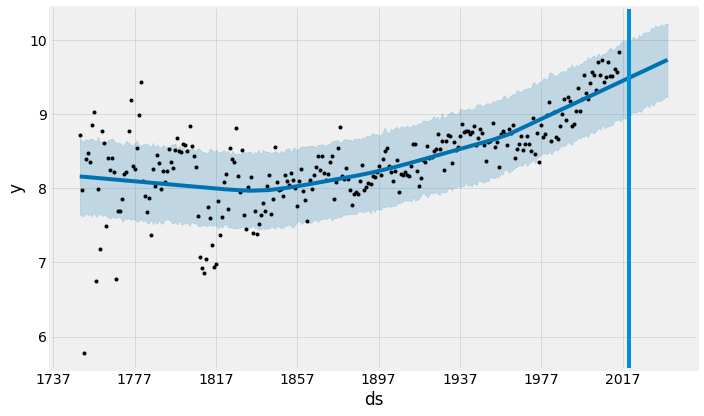

In [65]:
from datetime import datetime, timedelta
prophet.plot(forecast)
datenow = datetime.now()
plt.axvline(datenow)
#Add line to make view the current date easier

# 6. Discussion <a class="anchor" id="Discussion"></a>	

From my research of journals, articles and books, I believe that my findings and analysis respond accurately to the research at in the introduction. At the begging my using Prophet my parameters where off but through some change I believe it to be an accurate representation at the increase in temperature.

Things i would have done differently would be to look at a larger data set and use seasonality with Facebook Prophet to see how major changes in temperature would affect the result.


# 7. Conclusion <a class="anchor" id="Conclusion"></a>
I asked the question if temperatures on Earth are rising and answered it using Facebook Prophet to show they are.

Further research would be to look at RCP4.5 which is a is a greenhouse gas concentration trajectory, look at how GDP effects emissions in a country.


# 8. Reference List/Bibliography <a class="anchor" id="Reference"></a>

Dataset: From Kaggle: https://www.kaggle.com/berkeleyearth/climate-change-earth-surface-temperature-data Author: Berkely Earth

Folium map adapted from: https://www.kaggle.com/ash316/is-the-mercury-rising Author: Ashwini Swain

Animated Graph adpated from: https://pratapvardhan.com/blog/bar-chart-race-python-matplotlib/ Author: Pratap Vardhan

Prophet Graph adapted from: https://github.com/abaranovskis-redsamurai/automation-repo/blob/master/forecast/bikesharing_forecast_prophet.ipynb Author: https://github.com/abaranovskis-redsamurai

Consensus on consensus: a synthesis of consensus estimates on human-caused global warming: https://iopscience.iop.org/article/10.1088/1748-9326/11/4/048002 Authors: John Cook1, Naomi Oreskes, Peter T Doran, William R L Anderegg, Bart Verheggen, Ed W Maibach, J Stuart Carlton, Stephan Lewandowsky, Andrew G Skuce, Sarah A Green, Dana Nuccitelli, Peter Jacobs, Mark Richardson, Bärbel Winkler, Rob Painting and Ken Rice Published: 13 April 2016

2018 Fourth Warmest Year in Continued Warming Trend, According to NASA, NOAA: https://www.nasa.gov/press-release/2018-fourth-warmest-year-in-continued-warming-trend-according-to-nasa-noaa Author: Steve Cole Published: 06 February 2019

The Planet’s Temperature is Rising: https://www.ucsusa.org/resources/planets-temperature-rising Published: 17 November 2016